##Assignment 3: Data Visualization with Azure Databricks

Sana Mehrab Beigi

Data:[]([url](url)) Global Superstore Orders

- Row ID: Integer
- Order ID: String
- Order Date: String
- Ship Date: String
- Ship Mode: String
- Customer ID: String
- Customer Name: String
- Segment: String
- City: String
- State: String
- Country: String
- Postal Code: Float
- Market: String
- Region: String
- Product ID: String
- Category: String
- Sub-Category: String
- Product Name: String
- Sales: Float
- Quantity: Integer
- Discount: Float
- Profit: Float
- Shipping Cost: Float
- Order Priority: String

##1. Data Preparation

In [0]:
%python
# Import standard visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from pyspark.sql.functions import to_date
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Import Databricks visualization utilities
from pyspark.sql.functions import *
from pyspark.sql.types import *

# Configure matplotlib for Databricks
%matplotlib inline

# Set plot styling
plt.style.use('seaborn-whitegrid')
sns.set(style="whitegrid")

/root/.ipykernel/886/command-4204300802773678-4116814207:19: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


1.1 Loading data and converting date columns to proper timestamp format

Since I uploaded the file to the Filestore and read it using `inferSchema=True`, Spark automatically detected and assigned appropriate data types. This also ensured that date columns were correctly interpreted as timestamp formats without requiring manual conversion. Additionally, I utilized the following options to handle special cases in the data:

quote='"' → Treats text enclosed in double quotes ("") as a single value.

escape='"' → Correctly processes embedded quotes (e.g., "" is interpreted as ").

These configurations were necessary because some product names contained double quotes, which Spark initially misinterpreted as delimiters, incorrectly shifting values to the next column.

In [0]:
df = spark.read.csv("/FileStore/tables/GlobalSuperstoreOrders.csv", 
                    header=True, 
                    inferSchema=True, 
                    multiLine=True, 
                    quote='"', 
                    escape='"')


df = df.withColumn("Order Date", to_date("Order Date", "MM/dd/yyyy")) \
       .withColumn("Ship Date", to_date("Ship Date", "MM/dd/yyyy"))


display(df)
print(f"Number of records: {df.count()}\n")

print("Schema:")
df.printSchema()

Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,Country,Postal Code,Market,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
1783,MX-2014-116267,2014-12-31,2015-01-03,Second Class,EB-13975,Erica Bern,Corporate,S�o Paulo,S�o Paulo,Brazil,null,LATAM,South,TEC-CO-10000137,Technology,Copiers,"Canon Wireless Fax, Color",1264.466,5,0.002,301.466,253.25,High
26535,IN-2014-43550,2014-12-31,2015-01-01,First Class,ML-17395,Marina Lichtenstein,Corporate,Jakarta,Jakarta,Indonesia,null,APAC,Southeast Asia,FUR-BO-10004679,Furniture,Bookcases,"Safco Library with Doors, Pine",1091.2806,3,0.07,46.9206,243.11,High
44025,RS-2014-1460,2014-12-31,2015-01-02,Second Class,PB-9105,Peter B�hler,Consumer,Ufa,Bashkortostan,Russia,null,EMEA,EMEA,TEC-HEW-10004652,Technology,Copiers,"Hewlett Personal Copier, Laser",865.62,6,0.0,51.84,138.18,High
26333,IN-2014-30390,2014-12-31,2015-01-03,First Class,JD-16150,Justin Deggeller,Corporate,Bangkok,Bangkok,Thailand,null,APAC,Southeast Asia,FUR-TA-10001531,Furniture,Tables,"Lesro Training Table, Adjustable Height",1048.7313,9,0.57,-1195.2387,86.86,High
12929,ES-2014-3458802,2014-12-31,2015-01-05,Standard Class,JG-15805,John Grady,Corporate,Maidenhead,England,United Kingdom,null,EU,North,TEC-PH-10003683,Technology,Phones,"Motorola Audio Dock, VoIP",867.3,5,0.0,251.4,53.16,Medium
26335,IN-2014-30390,2014-12-31,2015-01-03,First Class,JD-16150,Justin Deggeller,Corporate,Bangkok,Bangkok,Thailand,null,APAC,Southeast Asia,FUR-CH-10003861,Furniture,Chairs,"Novimex Rocking Chair, Set of Two",292.7592,3,0.27,68.1192,52.11,High
15693,ES-2014-1695428,2014-12-31,2015-01-02,Second Class,RD-19480,Rick Duston,Consumer,Caen,Lower Normandy,France,null,EU,Central,OFF-ST-10002159,Office Supplies,Storage,"Fellowes Lockers, Wire Frame",557.28,3,0.1,216.72,51.79,Medium
1787,MX-2014-116267,2014-12-31,2015-01-03,Second Class,EB-13975,Erica Bern,Corporate,S�o Paulo,S�o Paulo,Brazil,null,LATAM,South,FUR-CH-10004844,Furniture,Chairs,"Novimex Swivel Stool, Adjustable",333.9,3,0.0,0.0,51.53,High
15297,ES-2014-5281275,2014-12-31,2015-01-04,Second Class,SS-20515,Shirley Schmidt,Home Office,Madrid,Madrid,Spain,null,EU,South,TEC-CO-10002284,Technology,Copiers,"Hewlett Copy Machine, Color",530.22,2,0.0,180.24,48.0,Medium
23679,IN-2014-75603,2014-12-31,2015-01-05,Second Class,BS-11365,Bill Shonely,Corporate,Vijayawada,Andhra Pradesh,India,null,APAC,Central Asia,OFF-SU-10001618,Office Supplies,Supplies,"Kleencut Letter Opener, Easy Grip",258.12,9,0.0,92.88,46.11,Medium


Number of records: 51290

Schema:
root
 |-- Row ID: integer (nullable = true)
 |-- Order ID: string (nullable = true)
 |-- Order Date: date (nullable = true)
 |-- Ship Date: date (nullable = true)
 |-- Ship Mode: string (nullable = true)
 |-- Customer ID: string (nullable = true)
 |-- Customer Name: string (nullable = true)
 |-- Segment: string (nullable = true)
 |-- City: string (nullable = true)
 |-- State: string (nullable = true)
 |-- Country: string (nullable = true)
 |-- Postal Code: integer (nullable = true)
 |-- Market: string (nullable = true)
 |-- Region: string (nullable = true)
 |-- Product ID: string (nullable = true)
 |-- Category: string (nullable = true)
 |-- Sub-Category: string (nullable = true)
 |-- Product Name: string (nullable = true)
 |-- Sales: double (nullable = true)
 |-- Quantity: integer (nullable = true)
 |-- Discount: double (nullable = true)
 |-- Profit: double (nullable = true)
 |-- Shipping Cost: double (nullable = true)
 |-- Order Priority: string (nul

In [0]:
num_rows = df.count()
num_cols = len(df.columns)

print(f"Number of rows: {num_rows}")
print(f"Number of columns: {num_cols}")

Number of rows: 51290
Number of columns: 24


1.2 Handle missing values appropriately

Since only U.S. locations in the dataset had postal codes, I chose to retain this valuable geographic information. To avoid losing these entries while maintaining dataset integrity, I replaced missing postal codes with 0 for non-U.S. records.

In [0]:
missing_values = df.select([count(when(col(c).isNull(), c)).alias(c) for c in df.columns])
display(missing_values)

Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,Country,Postal Code,Market,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
0,0,0,0,0,0,0,0,0,0,0,41296,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
df = df.fillna({'Postal Code': '0'})
display(df)

Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,Country,Postal Code,Market,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority
1783,MX-2014-116267,2014-12-31,2015-01-03,Second Class,EB-13975,Erica Bern,Corporate,S�o Paulo,S�o Paulo,Brazil,0,LATAM,South,TEC-CO-10000137,Technology,Copiers,"Canon Wireless Fax, Color",1264.466,5,0.002,301.466,253.25,High
26535,IN-2014-43550,2014-12-31,2015-01-01,First Class,ML-17395,Marina Lichtenstein,Corporate,Jakarta,Jakarta,Indonesia,0,APAC,Southeast Asia,FUR-BO-10004679,Furniture,Bookcases,"Safco Library with Doors, Pine",1091.2806,3,0.07,46.9206,243.11,High
44025,RS-2014-1460,2014-12-31,2015-01-02,Second Class,PB-9105,Peter B�hler,Consumer,Ufa,Bashkortostan,Russia,0,EMEA,EMEA,TEC-HEW-10004652,Technology,Copiers,"Hewlett Personal Copier, Laser",865.62,6,0.0,51.84,138.18,High
26333,IN-2014-30390,2014-12-31,2015-01-03,First Class,JD-16150,Justin Deggeller,Corporate,Bangkok,Bangkok,Thailand,0,APAC,Southeast Asia,FUR-TA-10001531,Furniture,Tables,"Lesro Training Table, Adjustable Height",1048.7313,9,0.57,-1195.2387,86.86,High
12929,ES-2014-3458802,2014-12-31,2015-01-05,Standard Class,JG-15805,John Grady,Corporate,Maidenhead,England,United Kingdom,0,EU,North,TEC-PH-10003683,Technology,Phones,"Motorola Audio Dock, VoIP",867.3,5,0.0,251.4,53.16,Medium
26335,IN-2014-30390,2014-12-31,2015-01-03,First Class,JD-16150,Justin Deggeller,Corporate,Bangkok,Bangkok,Thailand,0,APAC,Southeast Asia,FUR-CH-10003861,Furniture,Chairs,"Novimex Rocking Chair, Set of Two",292.7592,3,0.27,68.1192,52.11,High
15693,ES-2014-1695428,2014-12-31,2015-01-02,Second Class,RD-19480,Rick Duston,Consumer,Caen,Lower Normandy,France,0,EU,Central,OFF-ST-10002159,Office Supplies,Storage,"Fellowes Lockers, Wire Frame",557.28,3,0.1,216.72,51.79,Medium
1787,MX-2014-116267,2014-12-31,2015-01-03,Second Class,EB-13975,Erica Bern,Corporate,S�o Paulo,S�o Paulo,Brazil,0,LATAM,South,FUR-CH-10004844,Furniture,Chairs,"Novimex Swivel Stool, Adjustable",333.9,3,0.0,0.0,51.53,High
15297,ES-2014-5281275,2014-12-31,2015-01-04,Second Class,SS-20515,Shirley Schmidt,Home Office,Madrid,Madrid,Spain,0,EU,South,TEC-CO-10002284,Technology,Copiers,"Hewlett Copy Machine, Color",530.22,2,0.0,180.24,48.0,Medium
23679,IN-2014-75603,2014-12-31,2015-01-05,Second Class,BS-11365,Bill Shonely,Corporate,Vijayawada,Andhra Pradesh,India,0,APAC,Central Asia,OFF-SU-10001618,Office Supplies,Supplies,"Kleencut Letter Opener, Easy Grip",258.12,9,0.0,92.88,46.11,Medium


1.3 Create derived columns that will be useful for your analysis (e.g., order year, month, day of week, profit margin, etc.)

In [0]:
from pyspark.sql.functions import year, month, dayofweek

#Order Year, Month, Day of Week
df = df.withColumn("Order_Year", year("Order Date")) \
       .withColumn("Order_Month", month("Order Date")) \
       .withColumn("Order_DayOfWeek", dayofweek("Order Date"))  # 1 = Sunday, 7 = Saturday


#Profit Margin: how profitable the orders are relative to sales.
from pyspark.sql.functions import col

df = df.withColumn("Profit_Margin", (col("Profit") / col("Sales")).cast("double"))

#Shipping Duration: Calculate how long it took to ship an order (in days)
from pyspark.sql.functions import datediff

df = df.withColumn("Shipping_Duration", datediff("Ship Date", "Order Date"))

In [0]:
display(df)

Row ID,Order ID,Order Date,Ship Date,Ship Mode,Customer ID,Customer Name,Segment,City,State,Country,Postal Code,Market,Region,Product ID,Category,Sub-Category,Product Name,Sales,Quantity,Discount,Profit,Shipping Cost,Order Priority,Order_Year,Order_Month,Order_DayOfWeek,Profit_Margin,Shipping_Duration
1783,MX-2014-116267,2014-12-31,2015-01-03,Second Class,EB-13975,Erica Bern,Corporate,S�o Paulo,S�o Paulo,Brazil,0,LATAM,South,TEC-CO-10000137,Technology,Copiers,"Canon Wireless Fax, Color",1264.466,5,0.002,301.466,253.25,High,2014,12,4,0.2384136860935763,3
26535,IN-2014-43550,2014-12-31,2015-01-01,First Class,ML-17395,Marina Lichtenstein,Corporate,Jakarta,Jakarta,Indonesia,0,APAC,Southeast Asia,FUR-BO-10004679,Furniture,Bookcases,"Safco Library with Doors, Pine",1091.2806,3,0.07,46.9206,243.11,High,2014,12,4,0.04299590774361791,1
44025,RS-2014-1460,2014-12-31,2015-01-02,Second Class,PB-9105,Peter B�hler,Consumer,Ufa,Bashkortostan,Russia,0,EMEA,EMEA,TEC-HEW-10004652,Technology,Copiers,"Hewlett Personal Copier, Laser",865.62,6,0.0,51.84,138.18,High,2014,12,4,0.059887710542732384,2
26333,IN-2014-30390,2014-12-31,2015-01-03,First Class,JD-16150,Justin Deggeller,Corporate,Bangkok,Bangkok,Thailand,0,APAC,Southeast Asia,FUR-TA-10001531,Furniture,Tables,"Lesro Training Table, Adjustable Height",1048.7313,9,0.57,-1195.2387,86.86,High,2014,12,4,-1.1396996542393654,3
12929,ES-2014-3458802,2014-12-31,2015-01-05,Standard Class,JG-15805,John Grady,Corporate,Maidenhead,England,United Kingdom,0,EU,North,TEC-PH-10003683,Technology,Phones,"Motorola Audio Dock, VoIP",867.3,5,0.0,251.4,53.16,Medium,2014,12,4,0.28986509858180565,5
26335,IN-2014-30390,2014-12-31,2015-01-03,First Class,JD-16150,Justin Deggeller,Corporate,Bangkok,Bangkok,Thailand,0,APAC,Southeast Asia,FUR-CH-10003861,Furniture,Chairs,"Novimex Rocking Chair, Set of Two",292.7592,3,0.27,68.1192,52.11,High,2014,12,4,0.23267996360148546,3
15693,ES-2014-1695428,2014-12-31,2015-01-02,Second Class,RD-19480,Rick Duston,Consumer,Caen,Lower Normandy,France,0,EU,Central,OFF-ST-10002159,Office Supplies,Storage,"Fellowes Lockers, Wire Frame",557.28,3,0.1,216.72,51.79,Medium,2014,12,4,0.3888888888888889,2
1787,MX-2014-116267,2014-12-31,2015-01-03,Second Class,EB-13975,Erica Bern,Corporate,S�o Paulo,S�o Paulo,Brazil,0,LATAM,South,FUR-CH-10004844,Furniture,Chairs,"Novimex Swivel Stool, Adjustable",333.9,3,0.0,0.0,51.53,High,2014,12,4,0.0,3
15297,ES-2014-5281275,2014-12-31,2015-01-04,Second Class,SS-20515,Shirley Schmidt,Home Office,Madrid,Madrid,Spain,0,EU,South,TEC-CO-10002284,Technology,Copiers,"Hewlett Copy Machine, Color",530.22,2,0.0,180.24,48.0,Medium,2014,12,4,0.3399343668665837,4
23679,IN-2014-75603,2014-12-31,2015-01-05,Second Class,BS-11365,Bill Shonely,Corporate,Vijayawada,Andhra Pradesh,India,0,APAC,Central Asia,OFF-SU-10001618,Office Supplies,Supplies,"Kleencut Letter Opener, Easy Grip",258.12,9,0.0,92.88,46.11,Medium,2014,12,4,0.3598326359832636,5


###2. Visualization Creation

Converting to Pandas for Visualization

For more complex visualizations, it's often easier to convert PySpark DataFrames to Pandas:

In [0]:
%python
# Convert a sample to Pandas for visualization
pandas_df = df.toPandas()

# Check the resulting DataFrame
pandas_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51290 entries, 0 to 51289
Data columns (total 29 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Row ID             51290 non-null  int32  
 1   Order ID           51290 non-null  object 
 2   Order Date         51290 non-null  object 
 3   Ship Date          51290 non-null  object 
 4   Ship Mode          51290 non-null  object 
 5   Customer ID        51290 non-null  object 
 6   Customer Name      51290 non-null  object 
 7   Segment            51290 non-null  object 
 8   City               51290 non-null  object 
 9   State              51290 non-null  object 
 10  Country            51290 non-null  object 
 11  Postal Code        51290 non-null  int32  
 12  Market             51290 non-null  object 
 13  Region             51290 non-null  object 
 14  Product ID         51290 non-null  object 
 15  Category           51290 non-null  object 
 16  Sub-Category       512

2.A. Temporal Analysis 

Create visualizations showing how sales and profits vary by:

Month of year(built-in Databricks visualizations)


In [0]:
from pyspark.sql.functions import sum

sales_over_month = df.groupBy("Order_Month") \
                     .agg(sum("Sales").alias("Total_Sales"),
                          sum("Profit").alias("Total_Profit")) \
                     .orderBy("Order_Month")

display(sales_over_month)

Order_Month,Total_Sales,Total_Profit
1,675133.6721399998,73535.38454000014
2,543739.3799200007,70932.19921999991
3,770500.9412599975,94087.52096000005
4,698561.2118399992,73513.63124000005
5,904012.3381800001,104509.78427999999
6,1269716.75364,147079.41684000022
7,749381.8367200017,78070.09172000003
8,1293833.165319994,151854.10972000015
9,1437380.1103599933,170438.18315999996
10,1168184.386279999,157269.3583799996


Databricks visualization. Run in Databricks to view.

Year-over-year trends(seaborn)

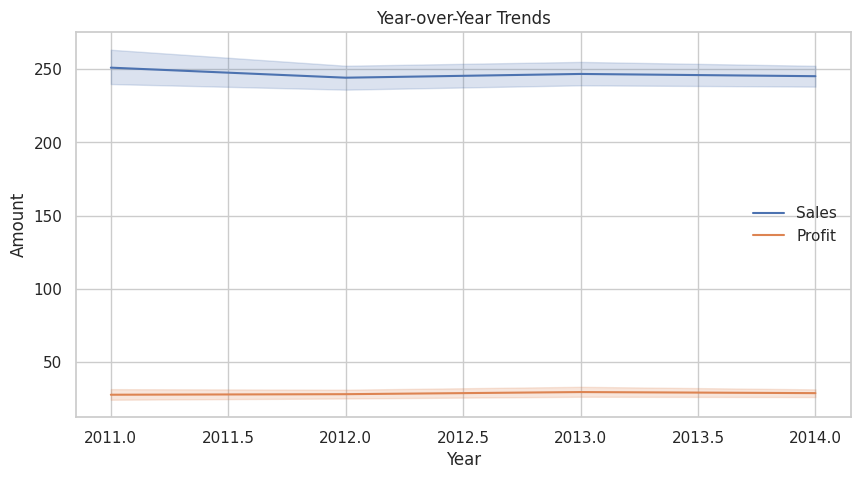

In [0]:
plt.figure(figsize=(10, 5))
sns.lineplot(data=pandas_df, x="Order_Year", y="Sales", label="Sales")
sns.lineplot(data=pandas_df, x="Order_Year", y="Profit", label="Profit")
plt.title("Year-over-Year Trends")
plt.xlabel("Year")
plt.ylabel("Amount")
plt.show()


Day of week(seaborn)

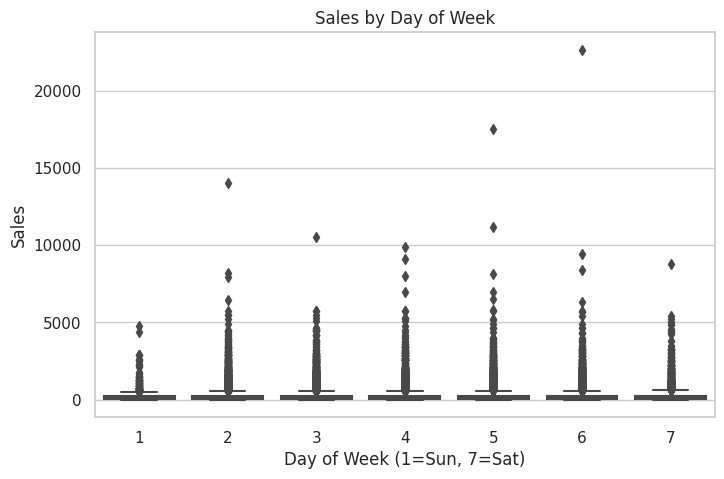

In [0]:
plt.figure(figsize=(8, 5))
sns.boxplot(data=pandas_df, x="Order_DayOfWeek", y="Sales")
plt.title("Sales by Day of Week")
plt.xlabel("Day of Week (1=Sun, 7=Sat)")
plt.ylabel("Sales")
plt.show()

Create a heatmap showing monthly sales patterns across different years(seaborn)

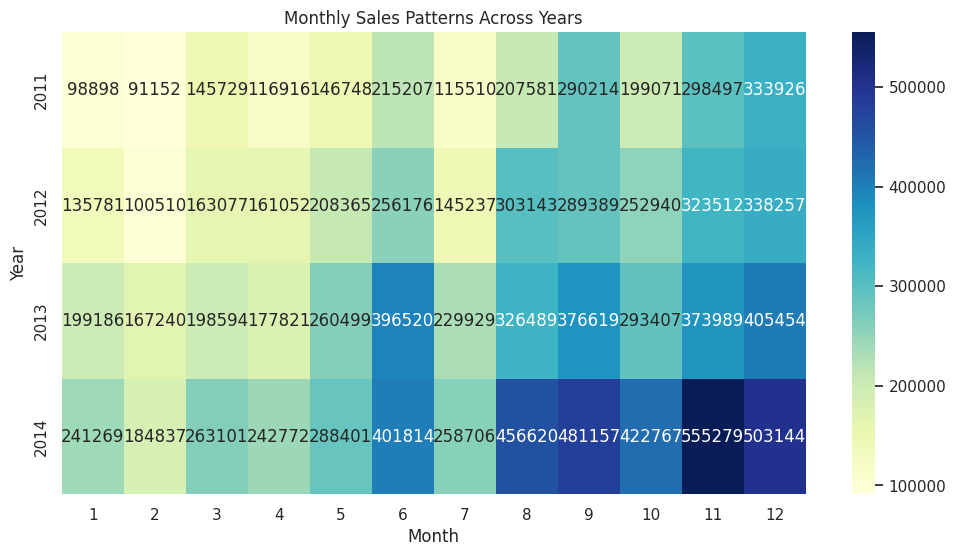

In [0]:
sales_pivot = pandas_df.pivot_table(index="Order_Year", columns="Order_Month", values="Sales", aggfunc="sum")
plt.figure(figsize=(12, 6))
sns.heatmap(sales_pivot, cmap="YlGnBu", annot=True, fmt=".0f")
plt.title("Monthly Sales Patterns Across Years")
plt.xlabel("Month")
plt.ylabel("Year")
plt.show()


Analyze the relationship between order date and ship date (delivery time)(MatplotLib)

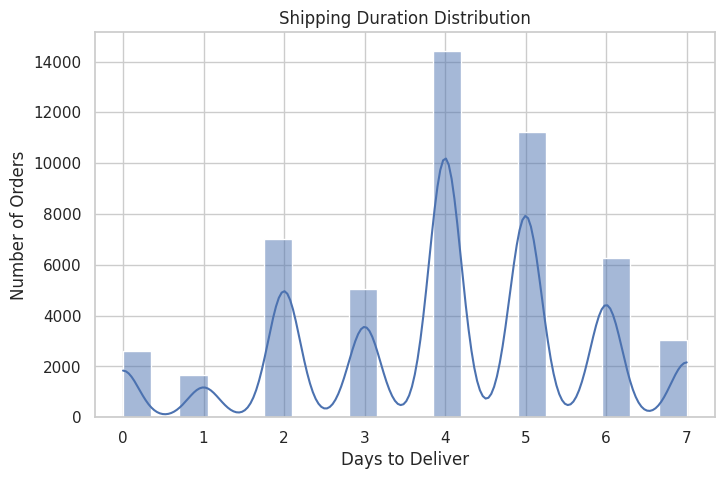

In [0]:
plt.figure(figsize=(8, 5))
sns.histplot(pandas_df["Shipping_Duration"], bins=20, kde=True)
plt.title("Shipping Duration Distribution")
plt.xlabel("Days to Deliver")
plt.ylabel("Number of Orders")
plt.show()


Visualize sales trends by different product categories over time(plotly)

In [0]:
fig = px.line(pandas_df, x="Order Date", y="Sales", color="Category", title="Sales by Category Over Time")
fig.show()


2.B. Financial Analysis

Visualize the distribution of sales, profits, and profit margins(Seaborn)

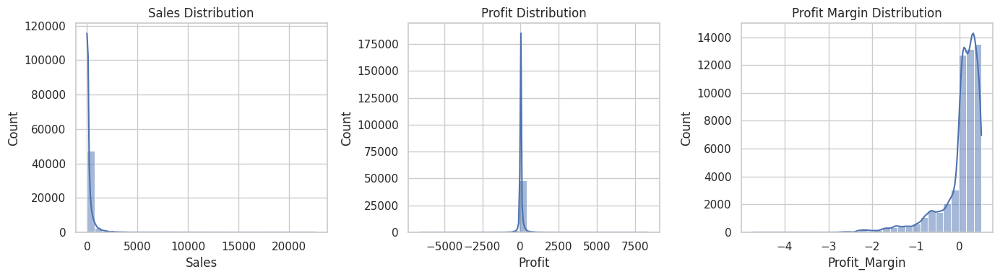

In [0]:
plt.figure(figsize=(14, 4))

plt.subplot(1, 3, 1)
sns.histplot(pandas_df['Sales'], kde=True, bins=30)
plt.title("Sales Distribution")

plt.subplot(1, 3, 2)
sns.histplot(pandas_df['Profit'], kde=True, bins=30)
plt.title("Profit Distribution")

plt.subplot(1, 3, 3)
sns.histplot(pandas_df['Profit_Margin'], kde=True, bins=30)
plt.title("Profit Margin Distribution")

plt.tight_layout()
plt.show()

# Relationship between Discount and Profit(Matplotlib)

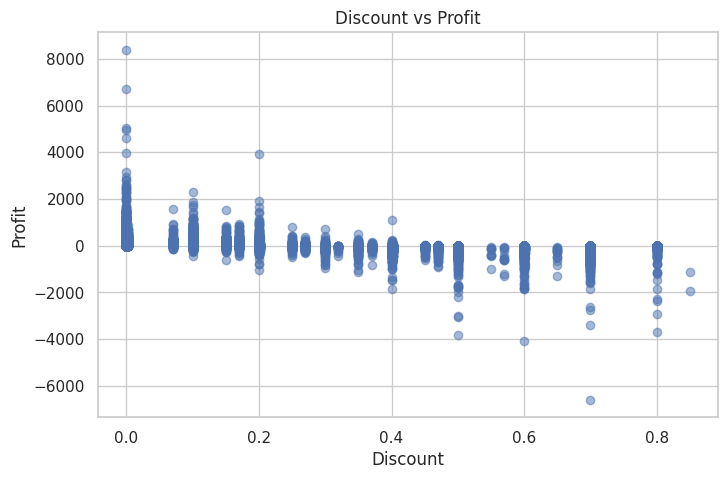

In [0]:
plt.figure(figsize=(8, 5))
plt.scatter(pandas_df['Discount'], pandas_df['Profit'], alpha=0.5)
plt.title("Discount vs Profit")
plt.xlabel("Discount")
plt.ylabel("Profit")
plt.grid(True)
plt.show()

How Shipping Cost Affects Profitability(Plotly)

In [0]:
fig = px.scatter(pandas_df, x="Shipping Cost", y="Profit", 
                 color="Category", 
                 title="Shipping Cost vs Profit by Category",
                 size="Sales", 
                 hover_data=['Order Priority'])
fig.show()


Factors Correlating with Profit(Databricks Built-in Heatmap)

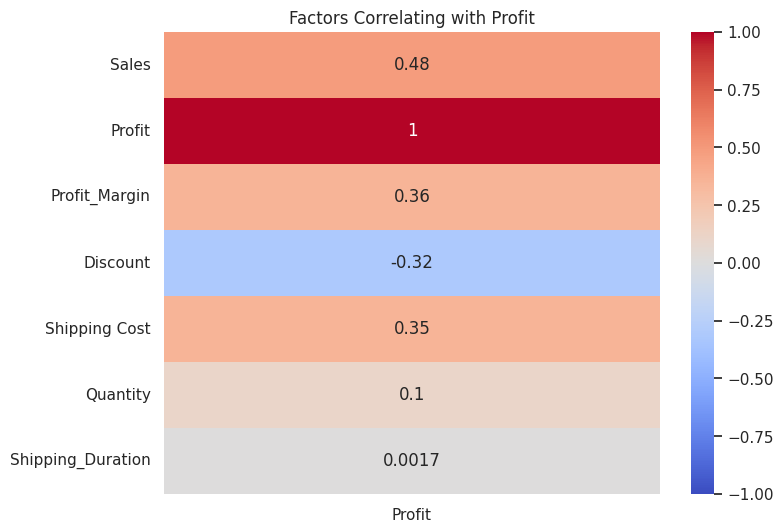

In [0]:
# Calculate correlations
correlation_df = pandas_df[['Sales', 'Profit', 'Profit_Margin', 'Discount', 'Shipping Cost', 'Quantity', 'Shipping_Duration']].corr()

# Factors Correlating with Profit
profit_correlation = correlation_df[['Profit']]

# Visualize the correlation with a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(profit_correlation, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Factors Correlating with Profit")
plt.show()

Compare Order Priorities by Sales and Profit(Seaborn)

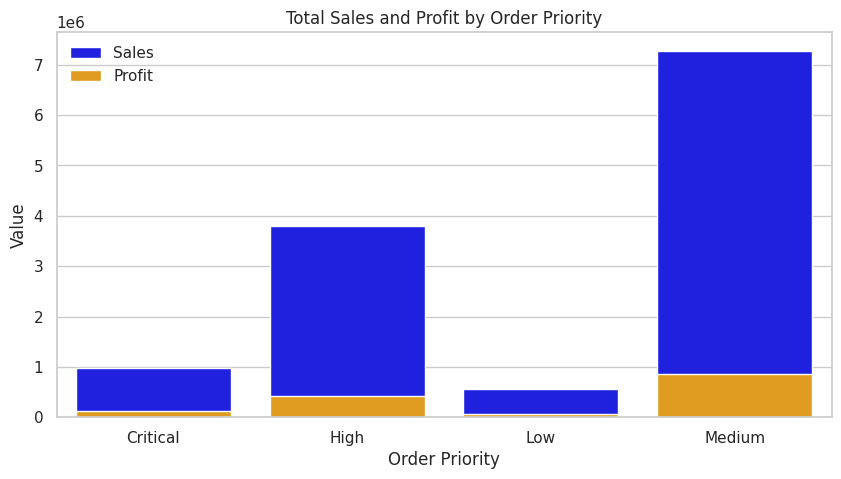

In [0]:
plt.figure(figsize=(10, 5))
sns.barplot(data=pandas_df, x="Order Priority", y="Sales", estimator=np.sum, errorbar=None, color='blue', label='Sales')
sns.barplot(data=pandas_df, x="Order Priority", y="Profit", estimator=np.sum, errorbar=None, color='orange', label='Profit')
plt.title("Total Sales and Profit by Order Priority")
plt.ylabel("Value")
plt.legend()
plt.show()

2.C. Geographic Analysis`

Sales and Profits by Country or Region - Plotly Choropleth (Best for mapping across countries)

In [0]:
country_summary = pandas_df.groupby("Country")[["Sales", "Profit"]].sum().reset_index()

fig = px.choropleth(country_summary, 
                    locations="Country", 
                    locationmode="country names", 
                    color="Sales",
                    hover_name="Country", 
                    color_continuous_scale="Viridis",
                    title="Global Sales by Country")
fig.show()

Most Profitable and Unprofitable Markets - Matplotlib Horizontal Bar Chart (Clear for ranked comparisons)

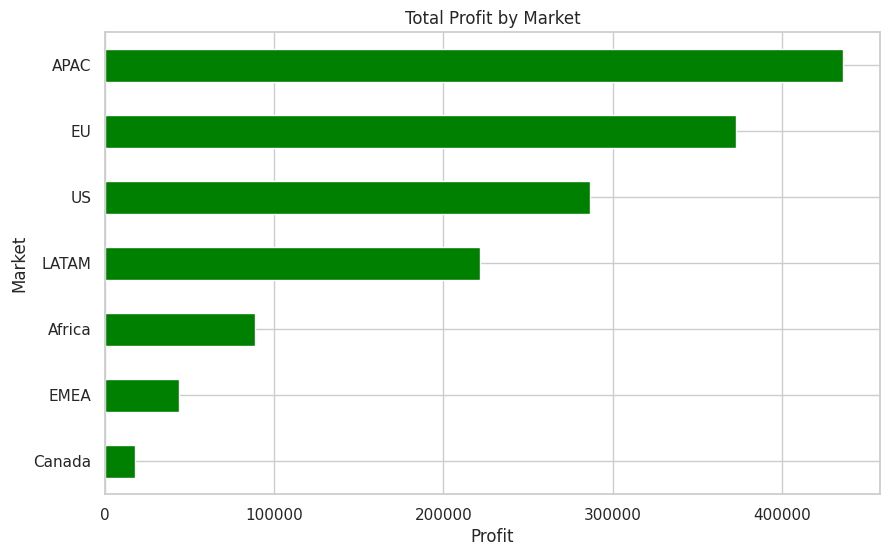

In [0]:
market_profit = pandas_df.groupby("Market")["Profit"].sum().sort_values()

plt.figure(figsize=(10, 6))
market_profit.plot(kind='barh', color=['red' if p < 0 else 'green' for p in market_profit])
plt.title("Total Profit by Market")
plt.xlabel("Profit")
plt.ylabel("Market")
plt.grid(True, axis='x')
plt.show()


Product Preferences by Region - Seaborn Heatmap (Best for dense comparisons)

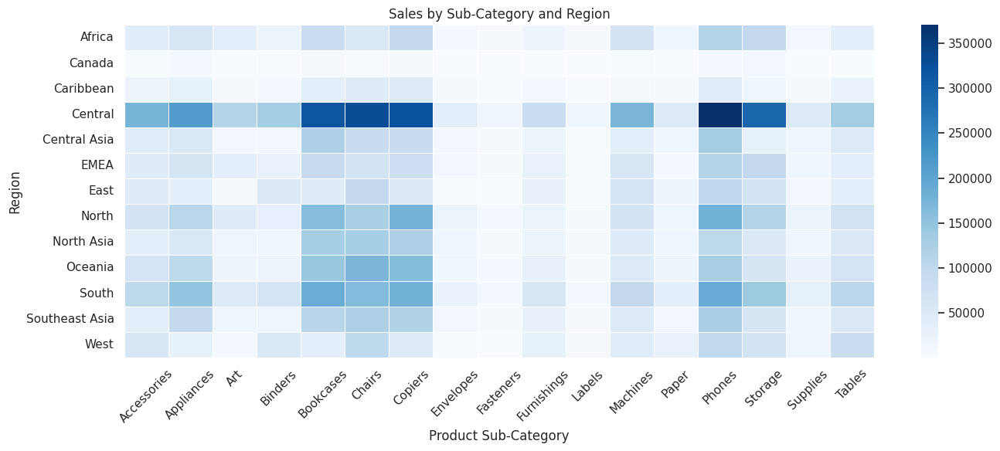

In [0]:
product_region = pandas_df.groupby(["Region", "Sub-Category"])["Sales"].sum().unstack().fillna(0)

plt.figure(figsize=(14, 6))
sns.heatmap(product_region, cmap="Blues", annot=False, linewidths=0.5)
plt.title("Sales by Sub-Category and Region")
plt.xlabel("Product Sub-Category")
plt.ylabel("Region")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Shipping Costs Across Regions - Databricks Built-in Visualization (Simple, clean comparison chart)

In [0]:
region_shipping = pandas_df.groupby("Region")[["Shipping Cost"]].mean().reset_index()
display(region_shipping)

Region,Shipping Cost
Africa,19.215057771964247
Canada,19.285494791666668
Caribbean,21.059260355029586
Central,26.71049383826572
Central Asia,38.0030029296875
EMEA,17.573221316365082
East,25.542001404494382
North,27.47629885057471
North Asia,40.646112061591104
Oceania,34.59377975336966


Databricks visualization. Run in Databricks to view.

D. Product and Customer Analysis Dashboard

Create a comprehensive dashboard with at least 4 complementary visualizations that tell a cohesive story about product performance and customer segments
Include visualizations of:

Sales and profits by product category and sub-category (Plotly Treemap (Great for hierarchical breakdown))

Customer segment performance(Seaborn Bar Plot)

Product profitability analysis(Databricks Built-in Table + Bar Chart)

Customer buying patterns(Plotly Sunburst (Shows how different segments buy products))

show them in one dashboard

I encounter memory error and couldnt download it.
so you can find the final step in another document